<a href="https://colab.research.google.com/github/rskarbez/colab_notebooks/blob/main/CSE2DV_2023_Week_9_lab_worksheet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CSE2DV - Week 9 lab notebook

In this week's lab - brought to you once again as a Google Colab worksheet - we're going to learn how to use Python libraries to visualize spatial data. Specifically, where last week we were using `pandas` and `seaborn`, this week we're going to use a library tailored specifically for geospatial visualization, [`folium`](https://pypi.org/project/folium/).

You should already be at least a little bit familiar with Python and Colab. With that said, let's get started by running the code in the next cell!

In [13]:
import folium

ltu_latlong = (-37.6949, 145.0623)

m = folium.Map(location=(ltu_latlong),
               control_scale=True)

m

This should bring up a map of greater Melbourne, centered on La Trobe's Bundoora campus. The map comes from [OpenStreetMap](https://www.openstreetmap.org/), the "free Wiki street map." This is the default behaviour for `folium`, but other tilesets are also built in: [Stamen](https://maps.stamen.com/) (artistically rendered maps) and [CartoDB](https://carto.com/).

In [14]:
m_watercolor = folium.Map(location=ltu_latlong,
                          control_scale=True,
                          tiles='stamen watercolor',
                          attr='tiles from Stamen')

m_watercolor

In [15]:
m_positron = folium.Map(location=ltu_latlong,
                        control_scale=True,
                        tiles='cartodb positron',
                        attr='tiles from Carto')

m_positron

You can manually place markers, lines, and polygons on a map. For an example of how to place a marker, see the following code cell. For more detailed information, see `folium's` [Getting started](https://python-visualization.github.io/folium/latest/getting_started.html) or [User guide](https://python-visualization.github.io/folium/latest/user_guide.html).

In [18]:
map_with_markers = m

folium.Marker(
    location=ltu_latlong,
    tooltip='Click me!',
    popup='Bundoora VIC, home of La Trobe University\'s Melbourne campus',
    icon=folium.Icon(color='red'),
).add_to(map_with_markers)

folium.Marker(
    location=[-37.8183, 144.9671],
    tooltip='Click me!',
    popup='Flinders Street Station, Melbourne CBD',
    icon=folium.Icon(color='green'),
).add_to(map_with_markers)

map_with_markers

The easiest way to work with geographic data in `folium` is to use data in the GeoJSON format. The following code cell demonstrates downloading json, adding it to a map, and using it to control a map overlay.

(NOTE: The first line brings in the Python `requests` library, a simple library for making HTTP requests. Most of the time, you can just use `requests.get` to download the data from a link, as in the following example. If you want/need more functionality, the documentation is available [here](https://requests.readthedocs.io/en/latest/).)

In [19]:
import requests

m_geojson = folium.Map(tiles="cartodbpositron")

geojson_data = requests.get(
    "https://raw.githubusercontent.com/python-visualization/folium-example-data/main/world_countries.json"
).json()

folium.GeoJson(geojson_data, name="hello world").add_to(m_geojson)

folium.LayerControl().add_to(m_geojson)

m_geojson

# Choropleth maps

One type of visualization that is enabled by geoplot is the choropleth map, which was discussed in lecture this week. Recall that a choropleth map is a type of geoviz in which map regions are coloured according to the value of a statistical variable, as in the following image:

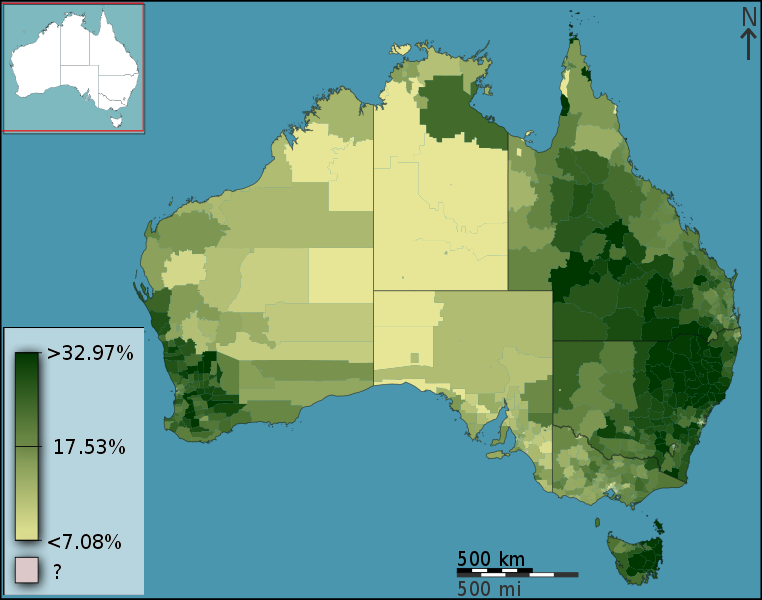

Let's make one! This time we'll be using `pandas`, as we did last week.

In [20]:
import pandas

state_geo = requests.get(
    "https://raw.githubusercontent.com/python-visualization/folium-example-data/main/us_states.json"
).json()
state_data = pandas.read_csv(
    "https://raw.githubusercontent.com/python-visualization/folium-example-data/main/us_unemployment_oct_2012.csv"
)

m_states = folium.Map(location=[48, -102], zoom_start=3)

folium.Choropleth(
    geo_data=state_geo,
    name="choropleth",
    data=state_data,
    columns=["State", "Unemployment"],
    key_on="feature.id",
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
).add_to(m_states)

folium.LayerControl().add_to(m_states)

m_states

For more information on, well, choropleth maps in `folium`, see the `folium` user guide on [Using `Choropleth`](https://python-visualization.github.io/folium/latest/user_guide/geojson/choropleth.html)

For now, let's see if we can make something like the Wikipedia image at the top of this section.

In [24]:
m_australia = folium.Map(location=(-23.07, 132.08), zoom_start=5)

australian_states = requests.get('https://raw.githubusercontent.com/tonywr71/GeoJson-Data/master/australian-states.json').json()

folium.Choropleth(
    geo_data=australian_states,
    fill_opacity=0.3,
    line_weight=2,
).add_to(m_australia)

m_australia

In [27]:
m_australia_suburblevel = folium.Map(location=(-23.07, 132.08), zoom_start=5)

australian_suburbs = requests.get('https://raw.githubusercontent.com/tonywr71/GeoJson-Data/master/australian-suburbs.geojson').json()

folium.Choropleth(
    geo_data=australian_suburbs,
    fill_opacity=0.3,
    line_weight=2,
).add_to(m_australia_suburblevel)

m_australia_suburblevel

**The code in the following cell SHOULD download and extract the local-government-area-level data from the 2021 census, but the Australian Bureau of Statistics website is a bit borked. You can try, but it may fail.**

If you want to try downloading the data manually, you can go [here](https://www.abs.gov.au/census/find-census-data/datapacks?release=2021&product=GCP&geography=LGA&header=S).

In [29]:
import zipfile, io

datapack_2023_zipped = requests.get('https://www.abs.gov.au/census/find-census-data/datapacks/download/2021_GCP_LGA_for_AUS_short-header.zip')
datapack_2023 = zipfile.ZipFile(io.BytesIO(datapack_2023_zipped.content))
datapack_2023.extractall()

BadZipFile: ignored

# Symbol maps

We actually already have everything we need to make a symbol map. Recall that we used the `folium.Marker()` function earlier in today's lab; this function puts a marker - with many customization options - on a map at a specified location. (For more documentation of the `Marker` function, see [here](https://python-visualization.github.io/folium/latest/user_guide/geojson/geojson_marker.html).)

In [35]:
import geopandas

nyc_subway_stations = geopandas.read_file('https://raw.githubusercontent.com/python-visualization/folium-example-data/main/subway_stations.geojson')

# Do some processing on the data

# Convert the url specified in the url property of the feature into a fully-formed web link
nyc_subway_stations['href'] = '<a href="' + nyc_subway_stations.url + '">' + nyc_subway_stations.url + "</a>"
# Convert the "notes" string into a list of service levels
nyc_subway_stations['service_level'] = nyc_subway_stations.notes.str.split(', ').apply(lambda x: len([v for v in x if "all" in v]))
# Convert the "line" string into a list of lines served by the station
nyc_subway_stations['lines_served'] = nyc_subway_stations.line.str.split('-').apply(lambda x: len(x))

service_levels = nyc_subway_stations.service_level.unique().tolist()

colors = ["orange", "yellow", "green", "blue"]

In [36]:
m_nycsubway = folium.Map(location=[40.75, -73.95], zoom_start=13)

folium.GeoJson(
    nyc_subway_stations,
    name="Subway Stations",
    marker=folium.Circle(radius=4, fill_color="orange", fill_opacity=0.4, color="black", weight=1),
    tooltip=folium.GeoJsonTooltip(fields=["name", "line", "notes"]),
    popup=folium.GeoJsonPopup(fields=["name", "line", "href", "notes"]),
    style_function=lambda x: {
        "fillColor": colors[x['properties']['service_level']],
        "radius": (x['properties']['lines_served'])*30,
    },
    highlight_function=lambda x: {"fillOpacity": 0.8},
    zoom_on_click=True,
).add_to(m_nycsubway)

m_nycsubway

# Dot density maps

We can again use the tools we already have to produce dot density maps.

In [37]:
istanbul_airbnb_data=pandas.read_csv("https://raw.githubusercontent.com/rskarbez/colab_notebooks/main/AirbnbIstanbul.csv")
istanbul_airbnb_data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,4826,The Place,6603,Kaan,NaN,Uskudar,41.05650,29.05367,Entire home/apt,554,1,1,2009-06-01,0.01,1,365
1,20815,The Bosphorus from The Comfy Hill,78838,Gülder,NaN,Besiktas,41.06984,29.04545,Entire home/apt,100,30,41,2018-11-07,0.38,2,49
2,25436,House for vacation rental furnutare,105823,Yesim,NaN,Besiktas,41.07731,29.03891,Entire home/apt,211,21,0,NaN,NaN,1,83
3,27271,LOVELY APT. IN PERFECT LOCATION,117026,Mutlu,NaN,Beyoglu,41.03220,28.98216,Entire home/apt,237,5,2,2018-05-04,0.04,1,228
4,28277,Duplex Apartment with Terrace,121607,Alen,NaN,Sisli,41.04471,28.98567,Entire home/apt,591,3,0,NaN,NaN,13,356


In [48]:
# Do some processing on the data
pruned_istanbul_airbnb = istanbul_airbnb_data[['latitude', 'longitude', 'price']]
min_price = pruned_istanbul_airbnb['price'].min()
max_price = pruned_istanbul_airbnb['price'].max()
price_range = max_price - min_price
price_indices = [min_price,
                 105, # 25% interval
                 190, # 50% interval
                 327, # 75% interval
                 max_price]

pruned_istanbul_airbnb.describe()

,latitude,longitude,price
count,16251.000000,16251.000000,16251.000000
mean,41.026458,28.985388,354.723894
std,0.043198,0.114358,1428.938340
min,40.814690,28.032000,0.000000
25%,41.004360,28.974130,105.000000
50%,41.031350,28.984260,190.000000
75%,41.047810,29.022445,327.000000
max,41.414420,29.907780,59561.000000


In [42]:
m_istanbul = folium.Map(location=(41, 29),
                        zoom_start=10)

m_istanbul

In [49]:
# Make a colour map
import branca.colormap as cm

colourmap = cm.StepColormap(colors=['green', 'yellow', 'orange', 'red'],
                            index=price_indices,
                            vmin=min_price,
                            vmax=max_price)

for i in range(len(pruned_istanbul_airbnb)):
  folium.Circle(location=(pruned_istanbul_airbnb['latitude'][i], pruned_istanbul_airbnb['longitude'][i]),
                radius=2,
                fill=True,
                color=colourmap(pruned_istanbul_airbnb['price'][i])
  ).add_to(m_istanbul)

m_istanbul

# Cartograms

Recall that cartograms are maps that distort the physical sizes of areas so that they correspond to some value, as in the maps shown [here](https://www.viewsoftheworld.net/?p=734), where the sizes of constituencies are scaled to correspond with their populations. (In most geoviz examples, values that correspond with large geographical regions "seem" more important due to their size.)

Unfortunately, I am not yet aware of a good way to do this in `folium`. I suspect that it is possible - especially a hex-based implementation using `folium.Marker` - but have not found an example of such.

Watch this space.

# That's geoviz (using `folium`) for you

And that's it for today. See you next week.